<a href="https://colab.research.google.com/github/djinn09/sentiment_analysis/blob/main/Sentiment_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install plotly
!pip install cufflinks
!pip install textblob
!pip install contractions
!pip install -U spacy[cuda92]
!python -m spacy download en_core_web_sm 


Requirement already up-to-date: spacy[cuda92] in /usr/local/lib/python3.7/dist-packages (3.0.6)
2021-04-29 14:56:44.785534: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


## **Importing Libray**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS
import re
import spacy

%matplotlib inline

In [ ]:
import cufflinks as cf
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot 


In [ ]:
import plotly.offline as pyo
import plotly.graph_objs as go
from plotly.offline import iplot


In [ ]:
cf.go_offline()

In [ ]:
import contractions
contractions.add('mychange', 'my change')


In [ ]:
init_notebook_mode(connected=False)


In [ ]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML("""<script src="/static/components/requirejs/require.js"></script>"""))
  init_notebook_mode(connected=False)

In [ ]:
spacy.prefer_gpu()
nlp = spacy.load('en_core_web_sm', disable=[ "parser",  "ner" ])
 

## Reading Data

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/Project/Basic_Sentiment_Classification/data.csv")

In [ ]:
df.head()

,textID,text,sentiment
0,2a0463352b,that`s enough! I`ll do nothing for 2 hours.,neutral
1,f358968122,I have to go clothes shopping tomorrow I hate...,negative
2,449e7733f1,i am bored. :| any idea`s of a nice site?,neutral
3,6099baf6e8,I don`t think will want to come back (guys r...,negative
4,f946da7a04,_thomas if only the drinking game was tonight....,neutral


## Checking Na value and removing it

In [ ]:
df.isnull().sum()

textID       0
text         1
sentiment    0
dtype: int64

In [ ]:
df.dropna(subset=["text"], inplace=True)

In [ ]:
df.isnull().sum()

textID       0
text         0
sentiment    0
dtype: int64

In [ ]:
df.head()

,textID,text,sentiment
0,2a0463352b,that`s enough! I`ll do nothing for 2 hours.,neutral
1,f358968122,I have to go clothes shopping tomorrow I hate...,negative
2,449e7733f1,i am bored. :| any idea`s of a nice site?,neutral
3,6099baf6e8,I don`t think will want to come back (guys r...,negative
4,f946da7a04,_thomas if only the drinking game was tonight....,neutral


In [ ]:
" ".join(df["text"].to_list()[:500])

"that`s enough! I`ll do nothing for 2 hours. I have to go clothes shopping tomorrow  I hate it, but I have a serious 'clothes falling apart' situation here. i am bored. :| any idea`s of a nice site? I don`t think  will want to come back  (guys read your dms) _thomas if only the drinking game was tonight...I don`t have to work till 5 tomorrow my birthday is in 2 days I wish the sun would come out...I guess it doesn`t matter since I`m at work and can`t enjoy it anyways I am very sad because I have gone on the show McFly fan I am of them! no one ever gave me the info I`m sad all tubes closed on 9th and 10th of june  any idea of how to get to the venue? ****...plans were canceled.....another friday night at home  always write holy words in capital dude, ALLAH HAFIZ !  Dang! Of course, I`m just jealous `cuz I didn`t think of it first yay!! we`ll all move!! sorry dh is being Grr...  **** I had my hair cut today and my boyfriend didn`t notice.... _ I wish you were here NOWWW!!! grrrrrrr FreeS

## Expanding words that is contraction

In [ ]:
def cont_to_expt(x):
  if type(x) is str:
    return contractions.fix(x.replace("`", "'"))
  else:
    return x

In [ ]:
%%time
df["text"] = df["text"].apply(lambda x: cont_to_expt(x))

CPU times: user 179 ms, sys: 2.89 ms, total: 181 ms
Wall time: 182 ms


# Text lemmatization

In [ ]:
" ".join(df["text"].to_list()[:500])

"that is enough! I will do nothing for 2 hours. I have to go clothes shopping tomorrow  I hate it, but I have a serious 'clothes falling apart' situation here. i am bored. :| any idea's of a nice site? I do not think  will want to come back  (guys read your dms) _thomas if only the drinking game was tonight...I do not have to work till 5 tomorrow my birthday is in 2 days I wish the sun would come out...I guess it does not matter since I am at work and can not enjoy it anyways I am very sad because I have gone on the show McFly fan I am of them! no one ever gave me the info I am sad all tubes closed on 9th and 10th of june  any idea of how to get to the venue? ****...plans were canceled.....another friday night at home  always write holy words in capital dude, ALLAH HAFIZ !  Dang! Of course, I am just jealous 'cuz I did not think of it first yay!! we will all move!! sorry dh is being Grr...  **** I had my hair cut today and my boyfriend did not notice.... _ I wish you were here NOWWW!!!

## Counting **Text Length** and **word count**




In [ ]:
df["text_length"] = df["text"].apply(lambda x: len(x))

In [ ]:
df["word_count"] = df["text"].apply(lambda x: len(x.split()))

In [ ]:
df.head()

,textID,text,sentiment,text_length,word_count
0,2a0463352b,that is enough! I will do nothing for 2 hours.,neutral,46,10
1,f358968122,I have to go clothes shopping tomorrow I hate...,negative,111,20
2,449e7733f1,i am bored. :| any idea's of a nice site?,neutral,41,10
3,6099baf6e8,I do not think will want to come back (guys ...,negative,60,13
4,f946da7a04,_thomas if only the drinking game was tonight....,neutral,85,16


## Getting Average length of Words

In [ ]:
def get_avg_word_len(x):
  words = x.split()
  word_len = 0
  for word in words:
    word_len = word_len + len(word)
  return round(word_len/len(words),2)


get_avg_word_len("this is list of list in the lost of tuple")

3.2

In [ ]:
df["avg_word_len"] = df["text"].apply(lambda x: get_avg_word_len(x))

In [ ]:
df.head()

,textID,text,sentiment,text_length,word_count,avg_word_len
0,2a0463352b,that is enough! I will do nothing for 2 hours.,neutral,46,10,3.70
1,f358968122,I have to go clothes shopping tomorrow I hate...,negative,111,20,4.55
2,449e7733f1,i am bored. :| any idea's of a nice site?,neutral,41,10,3.20
3,6099baf6e8,I do not think will want to come back (guys ...,negative,60,13,3.54
4,f946da7a04,_thomas if only the drinking game was tonight....,neutral,85,16,4.38


## Plot of Sentiment 

In [ ]:
enable_plotly_in_cell()
df["sentiment"].iplot(
    kind="hist",
    colors="red",
    bins=50,
    xTitle="Sentiment",
    yTitle="COUNT",
    theme='solar', 
    mode='markers+lines',
    title="Sentiment Distibution")
plt.show()


#**Sentiment Distibution**



In [ ]:
enable_plotly_in_cell()
df["text_length"].iplot(
    kind="hist",
    colors="red",
    bins=50,
    xTitle="Sentiment Charactes",
    yTitle="COUNT",
    theme='solar', 
    mode='markers+lines',
    title="Sentiment Distibution")
plt.show()

# **Getting Top Common Words** 

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
def get_top_or_lst_n_words(x,n, rev=True,ngram_range=(1,1),stop_words=None):

  vec = CountVectorizer(ngram_range=ngram_range, stop_words=stop_words).fit(x)
  bow = vec.transform(x)
  sum_words = bow.sum(axis = 0)
  words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
  words_freq = sorted(words_freq,key = lambda x:x[1],reverse = rev)
  return words_freq[:n]

## **Unigram**

In [ ]:
x = ["this is the list list this this this"]

In [ ]:
get_top_or_lst_n_words(x,2,)

[('this', 4), ('list', 2)]

In [ ]:
top_words = get_top_or_lst_n_words(df["text"],30)

# Top 30 Most common words

In [ ]:
top_words

[('to', 7736),
 ('the', 6021),
 ('not', 4887),
 ('is', 4706),
 ('my', 4059),
 ('it', 3679),
 ('you', 3670),
 ('and', 3471),
 ('am', 3002),
 ('in', 2740),
 ('of', 2333),
 ('for', 2320),
 ('have', 2265),
 ('that', 2182),
 ('me', 2135),
 ('on', 2085),
 ('but', 1869),
 ('do', 1847),
 ('so', 1795),
 ('just', 1615),
 ('at', 1391),
 ('can', 1378),
 ('with', 1347),
 ('are', 1327),
 ('be', 1326),
 ('was', 1298),
 ('will', 1291),
 ('now', 1170),
 ('going', 1160),
 ('no', 1157)]

In [ ]:
df1 = pd.DataFrame(top_words,columns = ["Unigram", "Frequency"])
df1.set_index("Unigram",inplace=True)


In [ ]:
enable_plotly_in_cell()
df1.iplot(
    kind="bar",
    colors="red",
    bins=50,
    xTitle="Unigram",
    yTitle="Count",
    theme='solar', 
    mode='markers+lines',
    title="Top 30 Unigrams Words")
plt.show()

## **Bigram**

In [ ]:
top_bigram_words = get_top_or_lst_n_words(df["text"],20,ngram_range=(2,2))

In [ ]:
df2 = pd.DataFrame(top_bigram_words,columns = ["Bigram", "Frequency"])
df2.set_index("Bigram",inplace=True)

# Top 20 Most common bigram words

In [ ]:
df2.head(20)

,Frequency
Bigram,
it is,1029
do not,1002
going to,889
can not,823
in the,580
want to,516
to go,507
to be,471
did not,407


In [ ]:
enable_plotly_in_cell()
df2.iplot(
    kind="bar",
    colors="red",
    bins=50,
    xTitle="Bigram",
    yTitle="Count",
    theme='solar', 
    mode='markers+lines',
    title="Top 20 Bigrams Words")
plt.show()

# Trigram

In [ ]:
top_trigram_words = get_top_or_lst_n_words(df["text"],20,ngram_range=(3,3))

In [ ]:
df3 = pd.DataFrame(top_trigram_words,columns = ["trigram", "Frequency"])
df3.set_index("trigram",inplace=True)

In [ ]:
df3.head(20)

,Frequency
trigram,
am going to,206
http twitpic com,204
to go to,172
do not know,142
going to be,141
http bit ly,121
want to go,118
is going to,117
not want to,114


In [ ]:
enable_plotly_in_cell()
df3.iplot(
    kind="bar",
    colors="red",
    bins=50,
    xTitle="Trigram",
    yTitle="Count",
    theme='solar', 
    mode='markers+lines',
    title="Top 20 Trigrams Words")
plt.show()

#Unigram, Bigram, Trigram Without stopwords

###**Unigram**

In [ ]:
top_unigram_words = get_top_or_lst_n_words(df["text"],20,stop_words="english")

In [ ]:
df1 = pd.DataFrame(top_unigram_words,columns = ["Unigram", "Frequency"])
df1.set_index("Unigram",inplace=True)

In [ ]:
enable_plotly_in_cell()
df1.iplot(
    kind="bar",
    colors="red",
    bins=50,
    xTitle="Unigram",
    yTitle="Count",
    theme='solar', 
    mode='markers+lines',
    title="Top 20 Unigrams Words")
plt.show()

###**Bigram**

In [ ]:
top_bigram_words = get_top_or_lst_n_words(df["text"],20,ngram_range=(2,2))

In [ ]:
df2 = pd.DataFrame(top_bigram_words,columns = ["bigram", "Frequency"])
df2.set_index("bigram",inplace=True)

In [ ]:
enable_plotly_in_cell()
df2.iplot(
    kind="bar",
    colors="red",
    bins=50,
    xTitle="Bigram",
    yTitle="Count",
    theme='solar', 
    mode='markers+lines',
    title="Top 20 Bigram Words")
plt.show()

### **Trigram**

In [ ]:
top_trigram_words = get_top_or_lst_n_words(df["text"],20,ngram_range=(3,3))


In [ ]:
df3 = pd.DataFrame(top_trigram_words,columns = ["trigram", "Frequency"])
df3.set_index("trigram",inplace=True)

In [ ]:
enable_plotly_in_cell()
df3.iplot(
    kind="bar",
    colors="red",
    bins=50,
    xTitle="trigram",
    yTitle="Count",
    theme='solar', 
    mode='markers+lines',
    title="Top 20 trigram Words")
plt.show()

## Top Unigram according to sentiment

## Neutral top words




In [ ]:
top_unigram_neutral_words = get_top_or_lst_n_words(df[df["sentiment"]=="neutral"]["text"],20,stop_words="english")

In [ ]:
df_neutral = pd.DataFrame(top_unigram_neutral_words,columns = ["Unigram", "Frequency"])
df_neutral.set_index("Unigram",inplace=True)
enable_plotly_in_cell()
df_neutral.iplot(
    kind="bar",
    colors="red",
    bins=50,
    xTitle="Unigram",
    yTitle="Count",
    theme='solar', 
    mode='markers+lines',
    title="Top 20 Unigram neutral Words")
plt.show()

## Negative top words


In [ ]:
top_unigram_negative_words = get_top_or_lst_n_words(df[df["sentiment"]=="negative"]["text"],20,stop_words="english")


In [ ]:
df_negative = pd.DataFrame(top_unigram_negative_words,columns = ["Unigram", "Frequency"])
df_negative.set_index("Unigram",inplace=True)
enable_plotly_in_cell()
df_negative.iplot(
    kind="bar",
    colors="red",
    bins=50,
    xTitle="Unigram",
    yTitle="Count",
    theme='solar', 
    mode='markers+lines',
    title="Top 20 Unigram Negative Words")
plt.show()

#WordCloud For neutral and negative words

###Negative

(-0.5, 999.5, 499.5, -0.5)

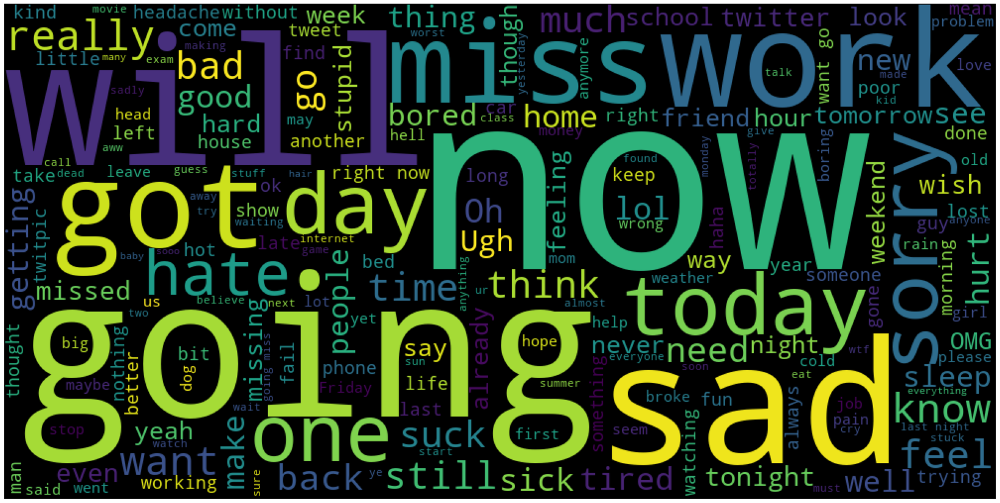

In [ ]:
k_negative = " ".join(df[df["sentiment"]=="negative"]["text"])
wordcloud = WordCloud(width = 1000, height = 500).generate(k_negative)
plt.figure(figsize=(30,15))
plt.imshow(wordcloud)
plt.axis('off')

###Neutral

(-0.5, 999.5, 499.5, -0.5)

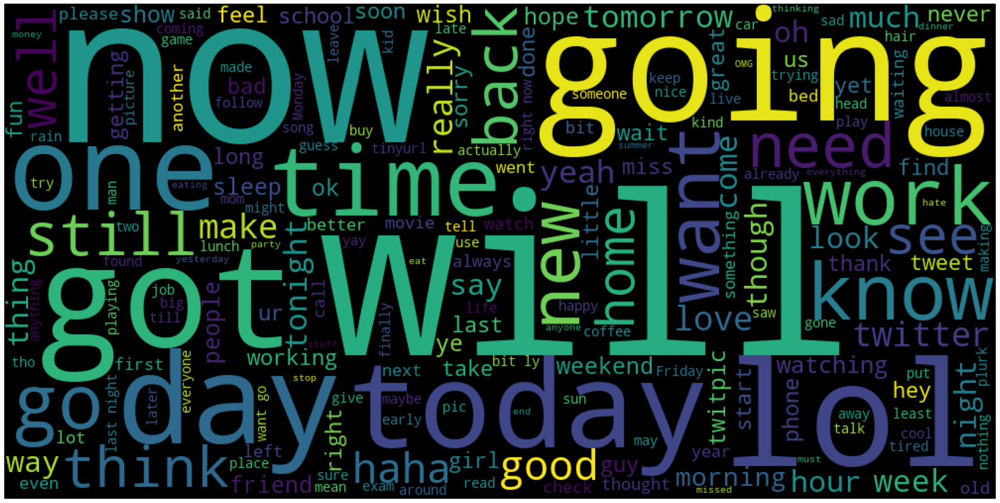

In [ ]:
k_neutral = " ".join(df[df["sentiment"]=="neutral"]["text"])
wordcloud = WordCloud(width = 1000, height = 500).generate(k_neutral)
plt.figure(figsize=(30,15))
plt.imshow(wordcloud)
plt.axis('off')

## Stop Words Count

In [ ]:
from spacy.lang.en.stop_words import STOP_WORDS


In [ ]:
df["stop_words_count"] = df["text"].apply(lambda x: len([t for t in x.split() if t in STOP_WORDS ]))

In [ ]:
df.head()

,textID,text,sentiment,text_length,word_count,avg_word_len,stop_words_count
0,2a0463352b,that is enough! I will do nothing for 2 hours.,neutral,46,10,3.70,6
1,f358968122,I have to go clothes shopping tomorrow I hate...,negative,111,20,4.55,7
2,449e7733f1,i am bored. :| any idea's of a nice site?,neutral,41,10,3.20,5
3,6099baf6e8,I do not think will want to come back (guys ...,negative,60,13,3.54,6
4,f946da7a04,_thomas if only the drinking game was tonight....,neutral,85,16,4.38,8


# Cleaning Text

In [ ]:
def lemmatize(text):
    """Perform lemmatization and stopword removal in the clean text
       Returns a list of lemmas
    """
    doc = nlp(text)
    lemma_list = [str(tok.lemma_).lower() for tok in doc if tok.is_alpha]
    return " ".join(lemma_list)
def processed_text(x, remove_stop_words=False):
  if isinstance(x,str):
    # removing url from text
    x = re.sub(r"(http|ftp|https)://([\w_-]+(?:(?:\.[\w_-]+)+))([\w.,@?^=%&:/~+#-]*[\w@?^=%&/~+#-])?", "", x)
    # removing email from text
    x = re.sub(r"([a-zA-Z0-9+._-]+@[a-zA-Z0-9._-]+\.[a-zA-Z0-9_-]+)","", x)
    # Removal of special chars and punctuation
    x = re.sub("[^a-z A-Z 0-9-]+", "", x)

    #Removing multiple spaces
    x = " ".join(x.split())
    # removing stop words
    if remove_stop_words:
      x =  " ".join([t for t in x.split() if t not in STOP_WORDS])
      
      # x = lemmatize(x)
    # lemmatization
    # x = lemmatize(x)
    # lowering words
    x = x.lower()
    return x
  else:
    return x
def pos_tag(x):
  return 


In [ ]:
!pip install pandarallel
!pip install ipywidgets
!jupyter nbextension enable --py widgetsnbextension
# !jupyter labextension install @jupyter-widgets/jupyterlab-manager

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: OK


In [ ]:
from pandarallel import pandarallel
pandarallel.initialize(nb_workers=8)


INFO: Pandarallel will run on 8 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.


In [ ]:
%%time
df["processed_text_with_stop_words"]  = df["text"].parallel_apply(lambda x: processed_text(x))


CPU times: user 36.1 ms, sys: 107 ms, total: 143 ms
Wall time: 357 ms


In [ ]:
%%time
df["processed_text_without_stop_words"]  = df["text"].parallel_apply(lambda x: processed_text(x, remove_stop_words=True))

CPU times: user 40.6 ms, sys: 117 ms, total: 157 ms
Wall time: 462 ms


In [ ]:
df.head(5)

,textID,text,sentiment,text_length,word_count,avg_word_len,stop_words_count,processed_text_with_stop_words,processed_text_without_stop_words
0,2a0463352b,that is enough! I will do nothing for 2 hours.,neutral,46,10,3.70,6,that is enough i will do nothing for 2 hours,i 2 hours
1,f358968122,I have to go clothes shopping tomorrow I hate...,negative,111,20,4.55,7,i have to go clothes shopping tomorrow i hate ...,i clothes shopping tomorrow i hate i clothes f...
2,449e7733f1,i am bored. :| any idea's of a nice site?,neutral,41,10,3.20,5,i am bored any ideas of a nice site,bored ideas nice site
3,6099baf6e8,I do not think will want to come back (guys ...,negative,60,13,3.54,6,i do not think will want to come back guys rea...,i think want come guys read dms
4,f946da7a04,_thomas if only the drinking game was tonight....,neutral,85,16,4.38,8,thomas if only the drinking game was tonighti ...,thomas drinking game tonighti work till 5 tomo...


# Word Cloud without stop words

## Neutral

(-0.5, 999.5, 499.5, -0.5)

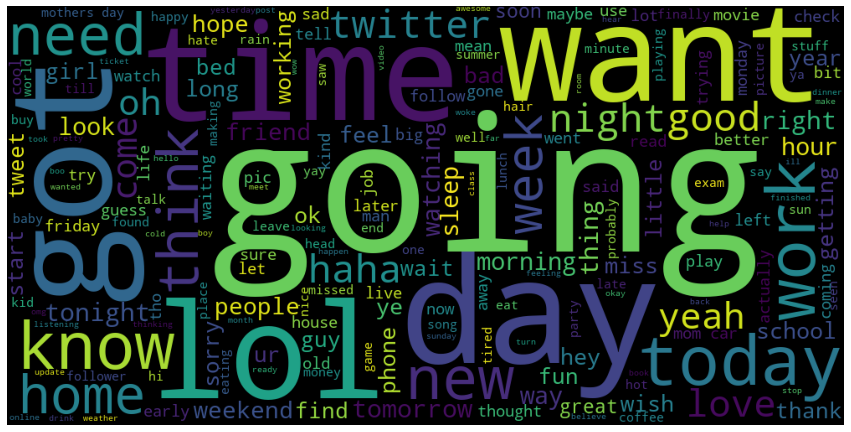

In [ ]:
k_neutral = " ".join(df[df["sentiment"]=="neutral"]["processed_text_without_stop_words"])
wordcloud = WordCloud(width = 1000, height = 500).generate(k_neutral)
plt.figure(figsize=(15,15))
plt.imshow(wordcloud)
plt.axis('off')

## Negative

(-0.5, 999.5, 499.5, -0.5)

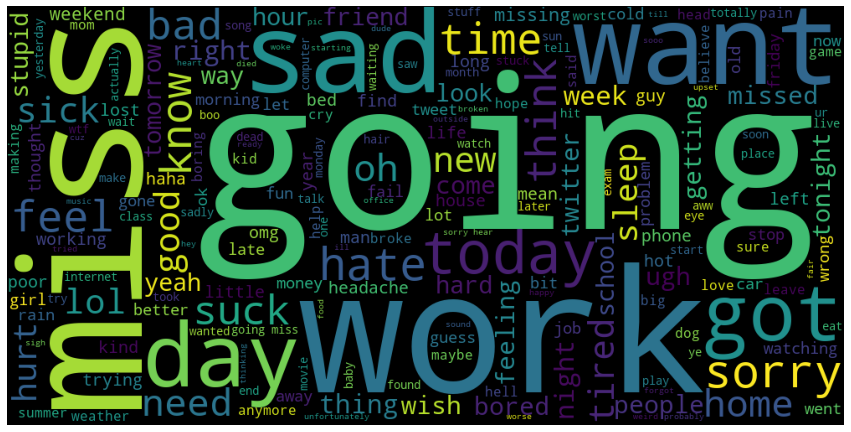

In [ ]:
k_neutral = " ".join(df[df["sentiment"]=="negative"]["processed_text_without_stop_words"])
wordcloud = WordCloud(width = 1000, height = 500).generate(k_neutral)
plt.figure(figsize=(15,15))
plt.imshow(wordcloud)
plt.axis('off')

In [ ]:
import nltk
from textblob import TextBlob
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


True

In [ ]:
text = " ".join(df["text"].to_list())
print(len(text))
blob = TextBlob(text)

1303393


In [ ]:
pos_df = pd.DataFrame(blob.tags,columns=["words","pos"])

In [ ]:
pos_df = pos_df["pos"].value_counts()


In [ ]:
enable_plotly_in_cell()
pos_df.iplot(
    kind="bar",
    colors="red",
    bins=50)
plt.show()

In [ ]:
!pip install pipelinehelper


In [ ]:
sentiment_text, labels = df["processed_text_with_stop_words"],df["sentiment"]

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import MaxAbsScaler, StandardScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.pipeline import Pipeline
from pipelinehelper import PipelineHelper
from sklearn.model_selection import GridSearchCV


# Downsampling Data For Unbalanced data

In [ ]:
from sklearn.utils import resample

X_train, X_test, y_train, y_test = train_test_split(sentiment_text, labels, test_size=.2, random_state=42)
# concatenate our training data back together
df = pd.concat([X_train, y_train], axis=1)

df_majority = df[df["sentiment"]=="neutral"]
df_minority = df[df["sentiment"]=="negative"]
 
# Downsample majority class
df_majority_downsampled = resample(df_majority, 
                                 replace=False,    # sample without replacement
                                 n_samples=len(df_majority),  # to match minority class
                                 random_state=1234) # reproducible results
 
# Combine minority class with downsampled majority class
df_downsampled = pd.concat([df_majority_downsampled, df_minority])
 
# Display new class counts
df_downsampled.sentiment.value_counts()

neutral     8933
negative    6185
Name: sentiment, dtype: int64

In [ ]:
sentiment_text, labels = df_downsampled["processed_text_with_stop_words"],df_downsampled["sentiment"]

In [ ]:
tf_idf = TfidfVectorizer (max_features=2900, min_df=7, max_df=0.8)
le = LabelEncoder()


In [ ]:
x = tf_idf.fit_transform(sentiment_text)
y = le.fit_transform(labels)

In [ ]:
# classifier
from sklearn.linear_model import SGDClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegressionCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC


In [ ]:

pipe = Pipeline([
    ('scaler', PipelineHelper([
        ('std', StandardScaler()),
        ('max', MaxAbsScaler()),
    ])),
    ('classifier', PipelineHelper([
        ('svm', LinearSVC()),
        ('rf', RandomForestClassifier()),
        ('lgcv', LogisticRegressionCV()),
        ('sgd', SGDClassifier()),
    ])),
])
params = {
    'scaler__selected_model': pipe.named_steps['scaler'].generate({
        'std__with_mean': [True, False],
        'std__with_std': [True, False],
        'max__copy': [True],  # just for displaying
    }),
    'classifier__selected_model': pipe.named_steps['classifier'].generate({
        'svm__C': [0.1, 1.0],
        'rf__n_estimators': [100, 20],
        "lgcv__cv": [4,10],
        "lgcv__random_state" : [0, 42],
        "sgd__max_iter":[200,1000], 
        "sgd__tol": [1e-3]
    })
}


In [ ]:
grid = GridSearchCV(pipe, params, scoring='accuracy', verbose=1)
grid.fit(x, y)


Fitting 5 folds for each of 50 candidates, totalling 250 fits


Streaming output truncated to the last 5000 lines.

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning:

GridSearchCV(cv=None, error_score=nan,
             estimator=Pipeline(memory=None,
                                steps=[('scaler',
                                        PipelineHelper(available_models={'max': MaxAbsScaler(copy=True),
                                                                         'std': StandardScaler(copy=True,
                                                                                               with_mean=True,
                                                                                               with_std=True)},
                                                       optional=False,
                                                       selected_model=None)),
                                       ('classifier',
                                        PipelineHelper(available_models={'lgcv': LogisticRegressionCV(Cs=10,
                                                                                                      class_weight=None,

In [ ]:
print(grid.best_params_)
print(grid.best_score_)

{'classifier__selected_model': ('sgd', {'max_iter': 200, 'tol': 0.001}), 'scaler__selected_model': ('std', {'with_mean': False, 'with_std': False})}
0.7594909485829102


In [ ]:
sgd = SGDClassifier(n_jobs=-1, random_state=42, max_iter=200)
lgr = LogisticRegression(random_state=42, max_iter=200)
lgr_cv = LogisticRegressionCV(cv=2, random_state=42, max_iter=1000)
svm = LinearSVC(random_state=42, max_iter=200)
rfc = RandomForestClassifier(random_state=42, n_jobs=-1, n_estimators=200)

In [ ]:
clf = {'SGD': sgd, 'LGR': lgr, 'LGR_CV': lgr_cv, 'SVM': svm, 'RFC': rfc}

In [ ]:
def classify(X,y):
    scaler = MaxAbsScaler()
    X = scaler.fit_transform(X)
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42, stratify = y)
    
    for key in clf.keys():
        clf[key].fit(X_train, y_train)
        y_pred = clf[key].predict(X_test)
        ac = accuracy_score(y_test, y_pred)
        print(key, ' ---> ' , ac)

In [ ]:
classify(x, y)

SGD  --->  0.7576058201058201
LGR  --->  0.75
LGR_CV  --->  0.7486772486772487
SVM  --->  0.7463624338624338
RFC  --->  0.7357804232804233


In [ ]:
scaler = StandardScaler(with_mean=False,with_std=False)
X = scaler.fit_transform(x)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=42)

In [ ]:

# sgd = SGDClassifier(max_iter=200, tol=0.001,n_jobs=-1)
rfc = RandomForestClassifier(random_state=42, n_jobs=-1, n_estimators=200)
# sgd.fit(X_train, y_train)
rfc.fit(X_train,y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=200,
                       n_jobs=-1, oob_score=False, random_state=42, verbose=0,
                       warm_start=False)

In [ ]:
y_pred = sgd.predict(X_test)

ac = accuracy_score(y_test, y_pred)

In [ ]:
print("Accuracy -->", ac )

Accuracy --> 0.7642195767195767


In [ ]:

array = confusion_matrix(y_test, y_pred)

In [ ]:
from sklearn.metrics import plot_confusion_matrix

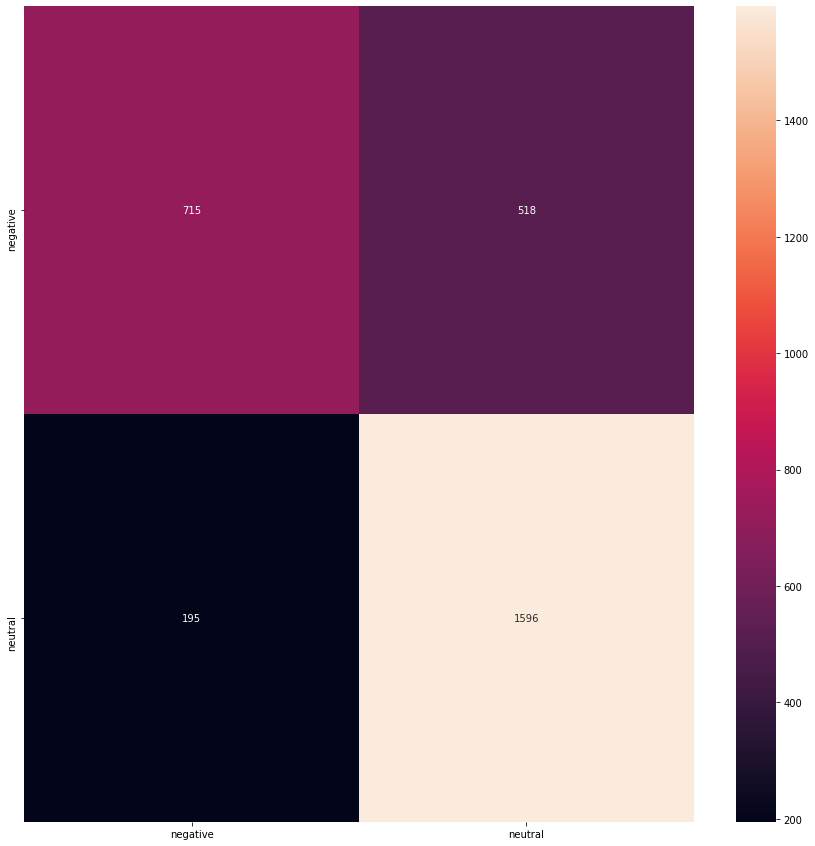

In [ ]:
df_cm = pd.DataFrame(array,index=le.classes_,columns=le.classes_)
plt.figure(figsize = (15,15))
sns.heatmap(df_cm, annot=True,fmt='g')


In [ ]:
# from sklearn.metrics import precision_score
from sklearn.metrics import recall_score

rs = recall_score(y_test, y_pred)
print(rs)

0.8911222780569514
